### Style Transfer

In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
import torchvision.models as models
from torchvision.utils import save_image
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np

In [4]:
def load_image(image_path, size=None):
    image = Image.open(image_path)
        
    loader = transforms.Compose([
        transforms.Resize(size),
        transforms.ToTensor(),
        transforms.Lambda(lambda x: x.unsqueeze(0))
    ])
    
    image = loader(image)
    return image.to(device)

# convert to range 0-1
def im_convert(tensor):
    image = tensor.cpu().clone().detach().numpy().squeeze().transpose(1,2,0).clip(0, 1)
    return image

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

vgg_mean = torch.tensor([0.485, 0.456, 0.406]).to(device)
vgg_std = torch.tensor([0.229, 0.224, 0.225]).to(device)

In [5]:
def preprocess(img):
    return ((img - vgg_mean.view(-1, 1, 1)) / vgg_std.view(-1, 1, 1))

def deprocess(img):
    return img * vgg_std.view(-1, 1, 1) + vgg_mean.view(-1, 1, 1)

def display_images(content_img, style_img, output_img=None):
    fig = plt.figure(figsize=(15, 5))
    
    plt.subplot(131)
    plt.imshow(im_convert(content_img))
    plt.title('Content Image')
    plt.axis('off')
    
    plt.subplot(132)
    plt.imshow(im_convert(style_img))
    plt.title('Style Image')
    plt.axis('off')
    
    if output_img is not None:
        plt.subplot(133)
        plt.imshow(im_convert(output_img))
        plt.title('Output Image')
        plt.axis('off')
    
    plt.show()

In [6]:
class ContentLoss(nn.Module):
    def __init__(self, target):
        super(ContentLoss, self).__init__()
        self.target = target.detach()
        
    def forward(self, input):
        self.loss = torch.mean((input - self.target) ** 2)
        return input

In [7]:
def gram_matrix(input):
    batch_size, channels, height, width = input.size()
    features = input.view(batch_size * channels, height * width)
    G = torch.mm(features, features.t())
    return G.div(batch_size * channels * height * width)

class StyleLoss(nn.Module):
    def __init__(self, target_feature):
        super(StyleLoss, self).__init__()
        self.target = gram_matrix(target_feature).detach()
        
    def forward(self, input):
        G = gram_matrix(input)
        self.loss = torch.mean((G - self.target) ** 2)
        return input

In [20]:
class StyleTransfer:
    def __init__(self):
        self.vgg = models.vgg19(weights=models.VGG19_Weights.DEFAULT).features.to(device).eval()
        
        for param in self.vgg.parameters():
            param.requires_grad_(False)
            
        self.content_layers = ['conv_4']
        self.style_layers = ['conv_1', 'conv_2', 'conv_3', 'conv_4', 'conv_5']

    def get_model_and_losses(self, content_img, style_img):
        content_losses = []
        style_losses = []
        
        model = nn.Sequential()
        
        i = 0 
        for layer in self.vgg.children():
            if isinstance(layer, nn.Conv2d):
                i += 1
                name = f'conv_{i}'
            elif isinstance(layer, nn.ReLU):
                name = f'relu_{i}'
                layer = nn.ReLU(inplace=False)
            elif isinstance(layer, nn.MaxPool2d):
                name = f'pool_{i}'
            elif isinstance(layer, nn.BatchNorm2d):
                name = f'bn_{i}'
            
            model.add_module(name, layer)
            
            if name in self.content_layers:
                target = model(content_img).detach()
                content_loss = ContentLoss(target)
                model.add_module(f"content_loss_{i}", content_loss)
                content_losses.append(content_loss)
                
            if name in self.style_layers:
                target_feature = model(style_img).detach()
                style_loss = StyleLoss(target_feature)
                model.add_module(f"style_loss_{i}", style_loss)
                style_losses.append(style_loss)
                
        return model, style_losses, content_losses
    
    def run_style_transfer(self, content_img, style_img, input_img, 
                          num_steps=300, style_weight=1000000, content_weight=1,
                          optimizer_type='lbfgs'):
        model, style_losses, content_losses = self.get_model_and_losses(content_img, style_img)
        
        input_img.requires_grad_(True)
        
        if optimizer_type == 'lbfgs':
            optimizer = optim.LBFGS([input_img], max_iter=1)
        else:
            optimizer = optim.Adam([input_img], lr=0.01)
        
        run = [0]
        best_loss = float('inf')
        best_img = None
        loss_history = {'style': [], 'content': [], 'total': []}
        
        def closure():
            with torch.no_grad():
                input_img.clamp_(0, 1)
            
            optimizer.zero_grad()
            model(input_img)
            
            style_score = 0
            content_score = 0
            
            for sl in style_losses:
                style_score += sl.loss
            for cl in content_losses:
                content_score += cl.loss
                
            torch.nn.utils.clip_grad_norm_([input_img], max_norm=1.0)
            
            style_score *= style_weight
            content_score *= content_weight
            
            loss = style_score + content_score
            
            loss_history['style'].append(style_score.item())
            loss_history['content'].append(content_score.item())
            loss_history['total'].append(loss.item())
            
            loss.backward()
            
            run[0] += 1
            if run[0] % 50 == 0:
                print(f"run {run[0]}:")
                print(f'Style Loss : {style_score.item():4f} Content Loss: {content_score.item():4f}')
                
                if loss.item() > best_loss * 10:  
                    return None
                
            return loss
        
        try:
            if optimizer_type == 'lbfgs':
                for step in range(num_steps):
                    loss = optimizer.step(closure)
                    
                    if loss is None:
                        break
                        
                    with torch.no_grad():
                        input_img.clamp_(0, 1) 
                        
                    if loss < best_loss:
                        best_loss = loss
                        best_img = input_img.clone()
            else: 
                for step in range(num_steps):
                    loss = closure()
                    
                    if loss is None:
                        break
                    
                    optimizer.step()
                    
                    with torch.no_grad():
                        input_img.clamp_(0, 1)
                        
                    if loss < best_loss:
                        best_loss = loss
                        best_img = input_img.clone()
        
        except RuntimeError as e:
            if best_img is not None:
                return best_img
            raise e
        
        return best_img if best_img is not None else input_img


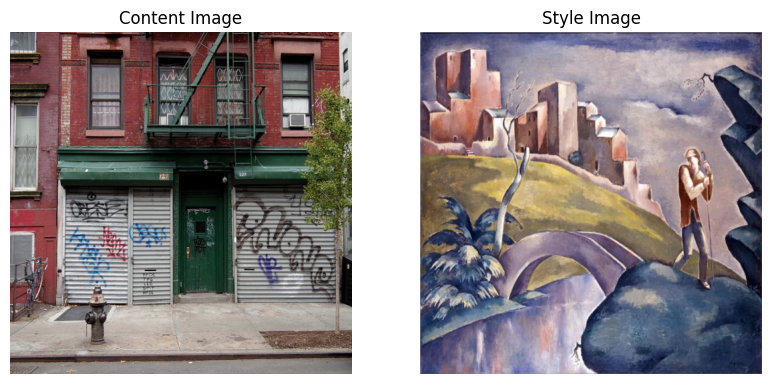

In [21]:
IMAGE_SIZE = (512, 512)

content_img = load_image('Q3/content/building.jpg', size=IMAGE_SIZE)
style_img = load_image('Q3/styles/landscape-with-a-palace.jpg', size=IMAGE_SIZE)

display_images(content_img, style_img)


Using lbfgs optimizer:

Content weight: 1

Style weight: 10000.0
run 50:
Style Loss : 0.309050 Content Loss: 0.475243
run 100:
Style Loss : 0.302528 Content Loss: 0.471959
run 150:
Style Loss : 0.300059 Content Loss: 0.470224
run 200:
Style Loss : 0.298169 Content Loss: 0.469324
run 250:
Style Loss : 0.296876 Content Loss: 0.468705
run 300:
Style Loss : 0.295828 Content Loss: 0.468304


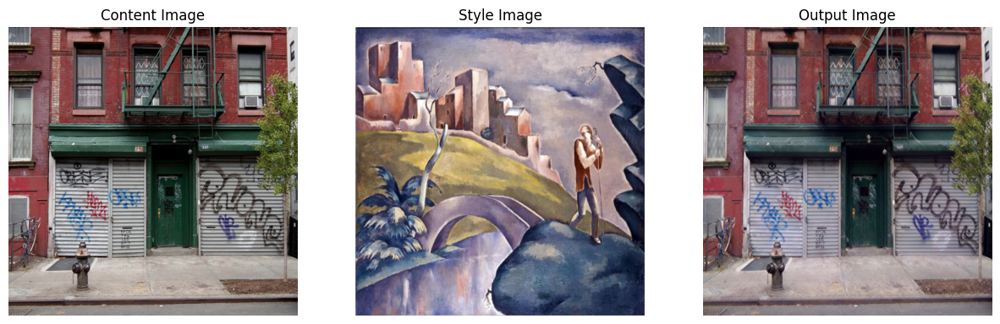


Style weight: 1000000.0
run 50:
Style Loss : 0.630350 Content Loss: 1.933484
run 100:
Style Loss : 0.359349 Content Loss: 1.765712
run 150:
Style Loss : 0.196113 Content Loss: 1.735999
run 200:
Style Loss : 0.168454 Content Loss: 1.699405
run 250:
Style Loss : 0.169534 Content Loss: 1.685291
run 300:
Style Loss : 0.225127 Content Loss: 1.685818


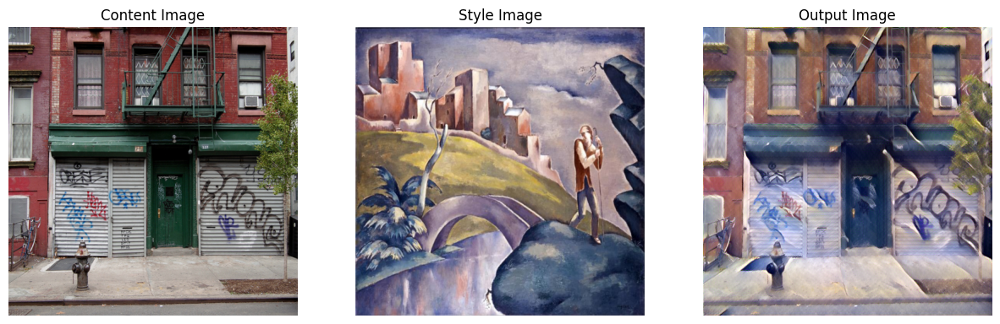


Style weight: 100000000.0
run 50:
Style Loss : 42.768497 Content Loss: 3.622535
run 100:
Style Loss : 17.635286 Content Loss: 3.685092
run 150:
Style Loss : 3.193403 Content Loss: 3.749930
run 200:
Style Loss : 1.140908 Content Loss: 3.502094
run 250:
Style Loss : 0.783986 Content Loss: 3.155167
run 300:
Style Loss : 0.605685 Content Loss: 2.967164


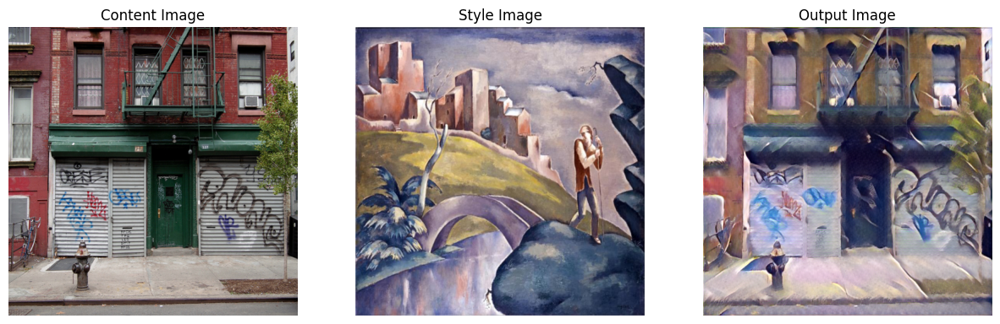


Content weight: 100.0

Style weight: 10000.0
run 50:
Style Loss : 2.970445 Content Loss: 0.197361
run 100:
Style Loss : 2.959339 Content Loss: 0.201277
run 150:
Style Loss : 2.953984 Content Loss: 0.203022
run 200:
Style Loss : 2.950506 Content Loss: 0.204118
run 250:
Style Loss : 2.947593 Content Loss: 0.205195
run 300:
Style Loss : 2.945366 Content Loss: 0.205977


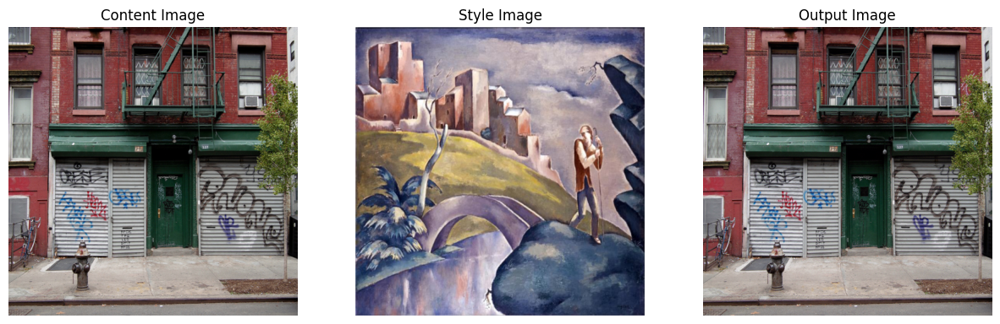


Style weight: 1000000.0
run 50:
Style Loss : 30.955679 Content Loss: 47.471806
run 100:
Style Loss : 30.254934 Content Loss: 47.195126
run 150:
Style Loss : 30.003433 Content Loss: 47.026623
run 200:
Style Loss : 29.819523 Content Loss: 46.933514
run 250:
Style Loss : 29.684324 Content Loss: 46.878304
run 300:
Style Loss : 29.579517 Content Loss: 46.834637


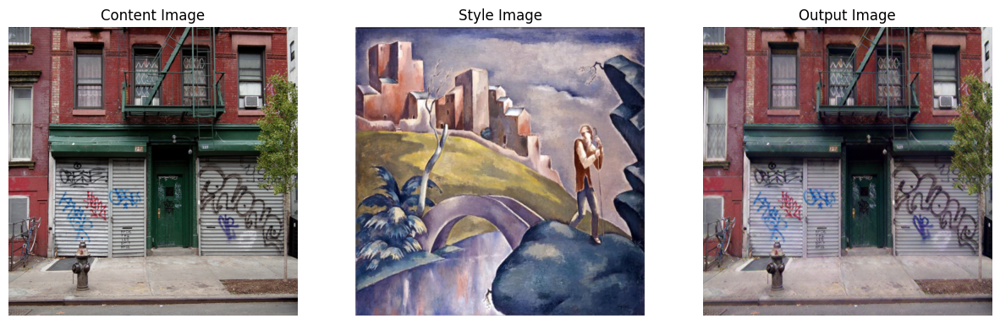


Style weight: 100000000.0
run 50:
Style Loss : 63.186054 Content Loss: 193.072693
run 100:
Style Loss : 36.091320 Content Loss: 176.239090
run 150:
Style Loss : 19.366255 Content Loss: 173.463516
run 200:
Style Loss : 16.783890 Content Loss: 169.890671
run 250:
Style Loss : 16.921871 Content Loss: 168.520752
run 300:
Style Loss : 16.613115 Content Loss: 168.053482


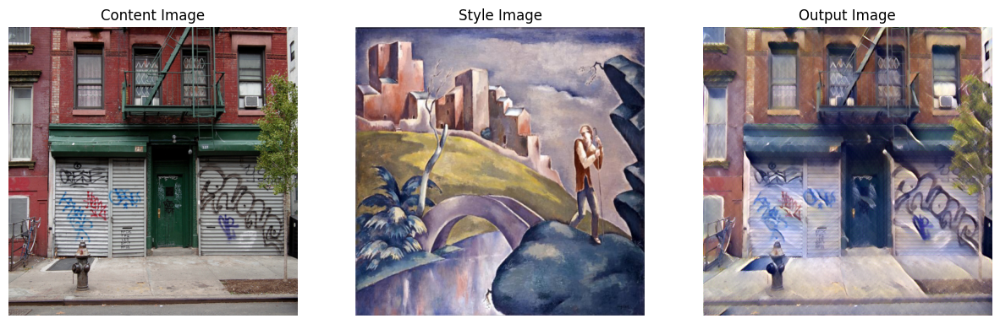


Using adam optimizer:

Content weight: 1

Style weight: 10000.0
run 50:
Style Loss : 0.314769 Content Loss: 0.486727
run 100:
Style Loss : 0.302573 Content Loss: 0.472453
run 150:
Style Loss : 0.298759 Content Loss: 0.470408
run 200:
Style Loss : 0.296603 Content Loss: 0.469391
run 250:
Style Loss : 0.295105 Content Loss: 0.468716
run 300:
Style Loss : 0.294137 Content Loss: 0.468055


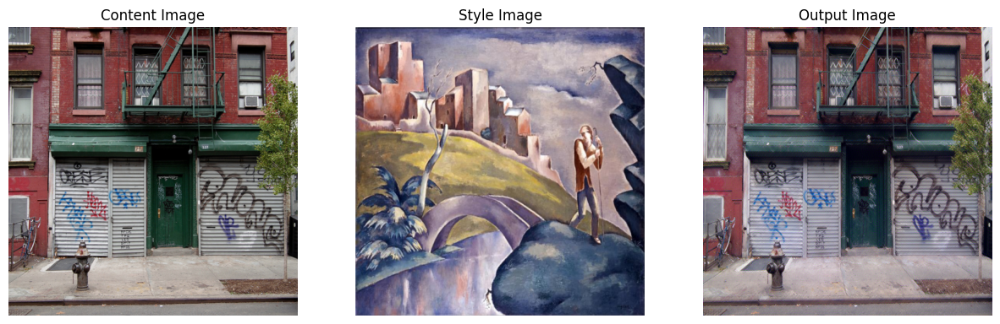


Style weight: 1000000.0
run 50:
Style Loss : 2.089934 Content Loss: 2.887780
run 100:
Style Loss : 0.978063 Content Loss: 2.426332
run 150:
Style Loss : 0.754699 Content Loss: 2.178983
run 200:
Style Loss : 0.634754 Content Loss: 2.047691
run 250:
Style Loss : 0.559906 Content Loss: 1.968216
run 300:
Style Loss : 0.508905 Content Loss: 1.915682


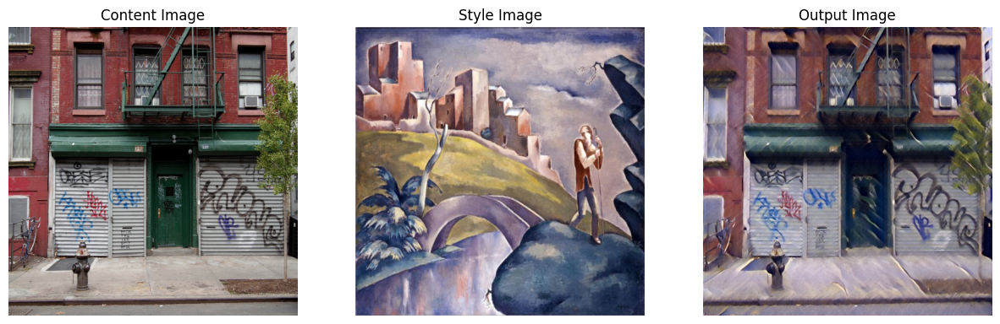


Style weight: 100000000.0
run 50:
Style Loss : 205.698227 Content Loss: 3.279392
run 100:
Style Loss : 80.689537 Content Loss: 3.473288
run 150:
Style Loss : 55.836910 Content Loss: 3.547843
run 200:
Style Loss : 43.418671 Content Loss: 3.600430
run 250:
Style Loss : 36.002411 Content Loss: 3.638755
run 300:
Style Loss : 31.184055 Content Loss: 3.665958


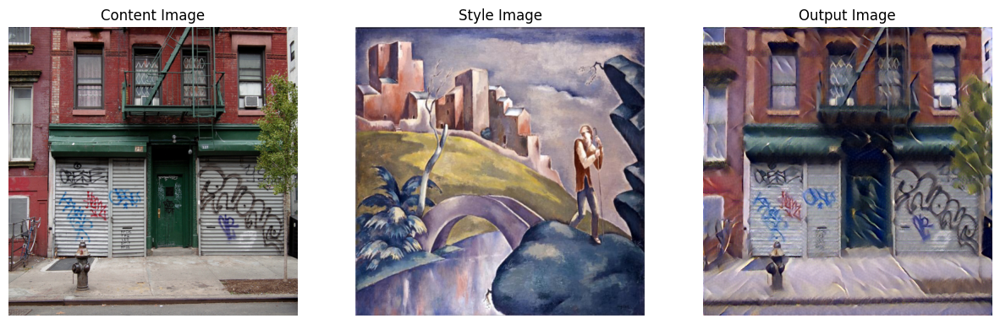


Content weight: 100.0

Style weight: 10000.0
run 50:
Style Loss : 2.978315 Content Loss: 0.264465
run 100:
Style Loss : 2.962099 Content Loss: 0.219542
run 150:
Style Loss : 2.956617 Content Loss: 0.217474
run 200:
Style Loss : 2.953037 Content Loss: 0.217421
run 250:
Style Loss : 2.950469 Content Loss: 0.218345
run 300:
Style Loss : 2.948455 Content Loss: 0.220319


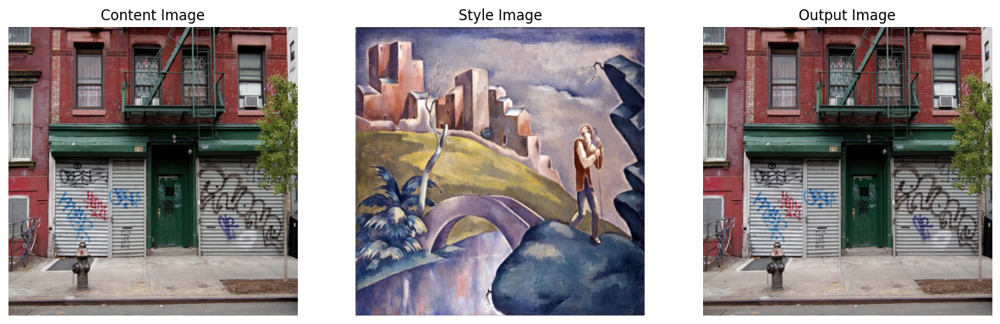


Style weight: 1000000.0
run 50:
Style Loss : 31.468008 Content Loss: 48.679184
run 100:
Style Loss : 30.259676 Content Loss: 47.242786
run 150:
Style Loss : 29.870668 Content Loss: 47.043373
run 200:
Style Loss : 29.654613 Content Loss: 46.945915
run 250:
Style Loss : 29.517658 Content Loss: 46.863068
run 300:
Style Loss : 29.410299 Content Loss: 46.811832


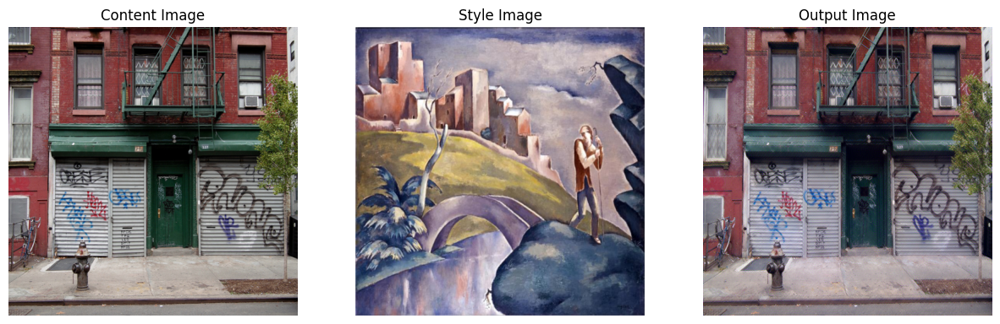


Style weight: 100000000.0
run 50:
Style Loss : 208.997192 Content Loss: 288.776123
run 100:
Style Loss : 97.813896 Content Loss: 242.636902
run 150:
Style Loss : 75.495605 Content Loss: 217.896561
run 200:
Style Loss : 63.488113 Content Loss: 204.751343
run 250:
Style Loss : 55.983639 Content Loss: 196.830154
run 300:
Style Loss : 50.879505 Content Loss: 191.604752


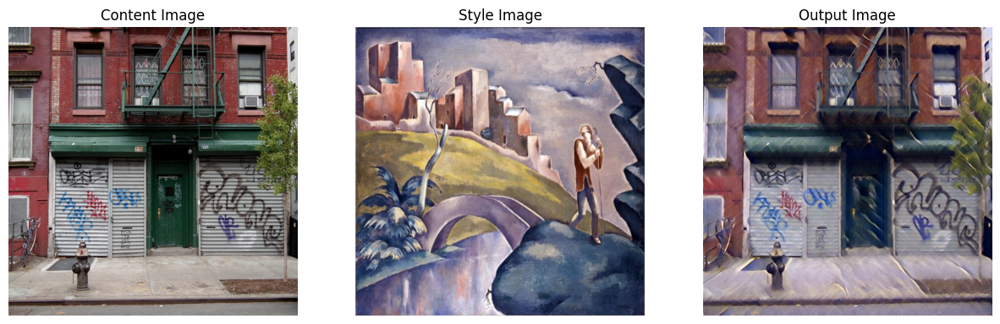

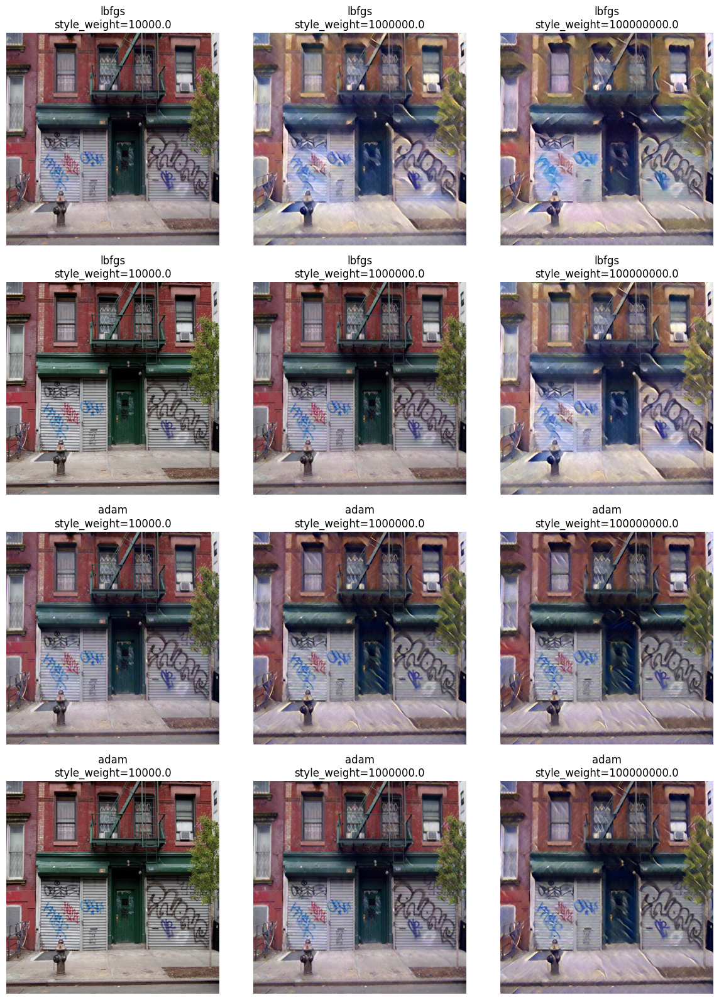

In [22]:
input_img = content_img.clone()

st = StyleTransfer()

style_weights = [1e4, 1e6, 1e8]
content_weights = [1, 1e2]

optimizers = ['lbfgs', 'adam']

results = []

for optimizer in optimizers:
    print(f"\nUsing {optimizer} optimizer:")
    for content_weight in content_weights:
        print(f"\nContent weight: {content_weight}")
        for style_weight in style_weights:
            print(f"\nStyle weight: {style_weight}")
            
            output = st.run_style_transfer(content_img, style_img, input_img.clone(),
                                        style_weight=style_weight,
                                        content_weight=content_weight,
                                        optimizer_type=optimizer,
                                        num_steps=300)
            
            save_image(output, f'output1/output_{optimizer}_{style_weight}.jpg')
            
            display_images(content_img, style_img, output)
            
            results.append({
                'optimizer': optimizer,
                'style_weight': style_weight,
                'output': output.clone()
            })

fig = plt.figure(figsize=(12, 16))
for idx, result in enumerate(results):
    plt.subplot(4, 3, idx + 1)
    plt.imshow(im_convert(result['output']))
    plt.title(f"{result['optimizer']}\nstyle_weight={result['style_weight']}")
    plt.axis('off')
plt.tight_layout()
plt.show()

Looking at the comparison between Adam and L-BFGS optimizers with varying style weights (10000.0, 1000000.0, and 10000000.0), we can observe several key differences. L-BFGS generally produces more stable and consistent results across different style weights, showing smoother transitions between content and style elements. The stylization becomes progressively stronger as the style weight increases, with the building's texture and colors taking on more artistic qualities while maintaining structural integrity. In contrast, Adam optimizer shows slightly more inconsistent results, with some artifacts and less smooth transitions between style and content elements, particularly at higher style weights


Regarding the impact of different style weights, we can see a clear progression in the stylization intensity. At style_weight=10000.0 (leftmost column), both optimizers maintain most of the original content with minimal style transfer, preserving the building's original colors and textures. At style_weight=1000000.0 (middle column), we see a balanced blend where the artistic style is more pronounced while still maintaining recognizable content features. At style_weight=10000000.0 (rightmost column), the style dominates significantly, creating a more abstract interpretation of the original image, with L-BFGS handling this extreme case more gracefully than Adam by maintaining better structural coherence.


Building the style transfer model..
Optimizing..
run 50:
Style Loss : 115302.640625 Content Loss: 184.365723
run 100:
Style Loss : 65995.921875 Content Loss: 209.725876
run 150:
Style Loss : 50148.308594 Content Loss: 222.669937
run 200:
Style Loss : 43417.207031 Content Loss: 231.360580
run 250:
Style Loss : 38943.171875 Content Loss: 238.234497
run 300:
Style Loss : 35227.890625 Content Loss: 243.480896


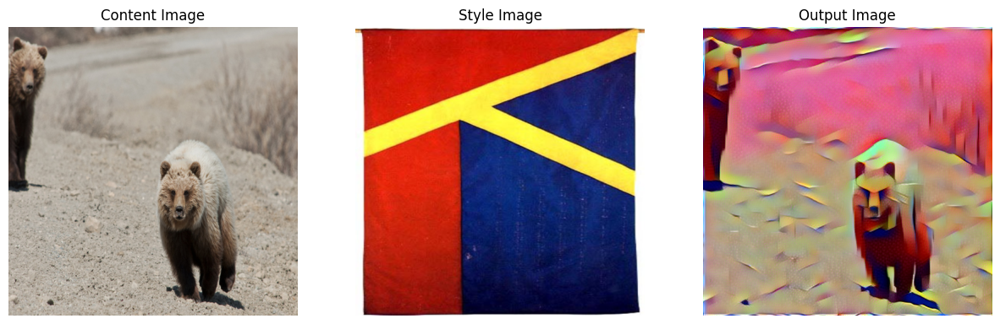

Building the style transfer model..
Optimizing..
run 50:
Style Loss : 147689.140625 Content Loss: 466.545868
run 100:
Style Loss : 71483.257812 Content Loss: 495.932770
run 150:
Style Loss : 50850.125000 Content Loss: 508.494995
run 200:
Style Loss : 39597.933594 Content Loss: 516.568970
run 250:
Style Loss : 31177.779297 Content Loss: 522.787659
run 300:
Style Loss : 24261.828125 Content Loss: 527.960449


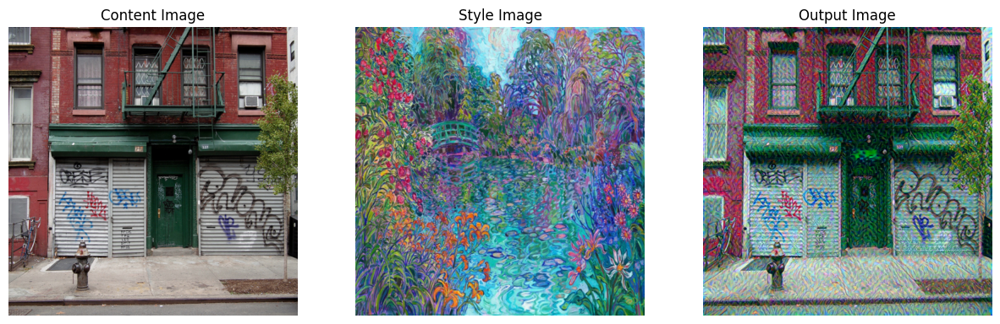

Building the style transfer model..
Optimizing..
run 50:
Style Loss : 19529.830078 Content Loss: 122.579025
run 100:
Style Loss : 16197.409180 Content Loss: 127.203133
run 150:
Style Loss : 14492.635742 Content Loss: 130.068237
run 200:
Style Loss : 12973.645508 Content Loss: 132.603195
run 250:
Style Loss : 11529.502930 Content Loss: 134.919159
run 300:
Style Loss : 10150.416992 Content Loss: 137.085571


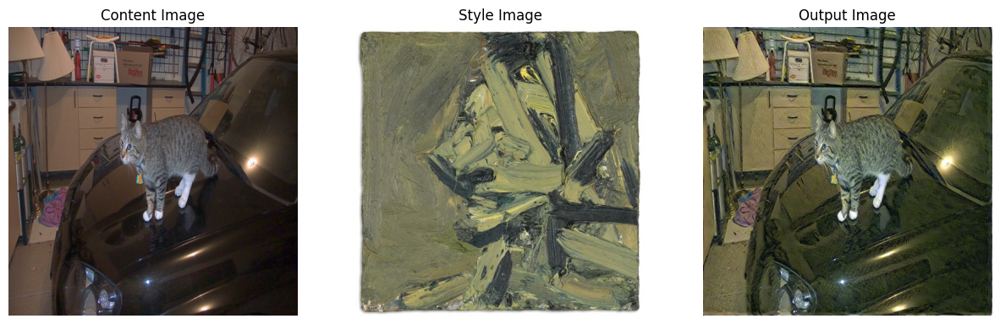

Building the style transfer model..
Optimizing..
run 50:
Style Loss : 11802.402344 Content Loss: 146.361954
run 100:
Style Loss : 4963.624512 Content Loss: 151.227875
run 150:
Style Loss : 2173.517090 Content Loss: 153.030533
run 200:
Style Loss : 1086.626953 Content Loss: 154.033463
run 250:
Style Loss : 681.694641 Content Loss: 154.532990
run 300:
Style Loss : 505.872009 Content Loss: 154.692200


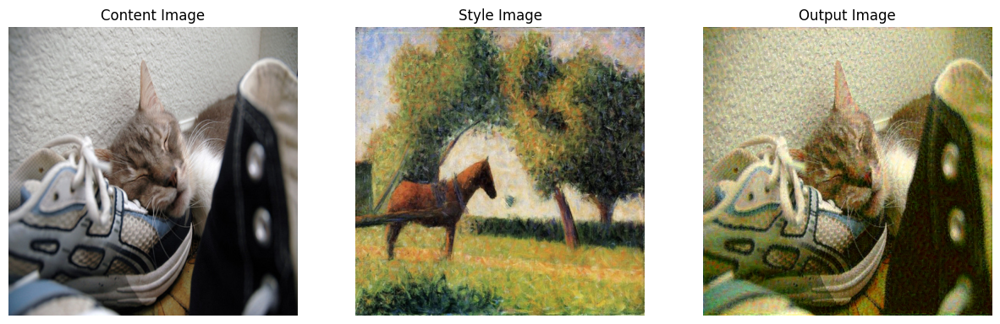

Building the style transfer model..
Optimizing..
run 50:
Style Loss : 14374.732422 Content Loss: 183.892731
run 100:
Style Loss : 7471.851074 Content Loss: 196.292343
run 150:
Style Loss : 5472.117188 Content Loss: 203.976196
run 200:
Style Loss : 4428.130859 Content Loss: 209.402161
run 250:
Style Loss : 3749.307129 Content Loss: 213.376785
run 300:
Style Loss : 3246.996338 Content Loss: 216.361496


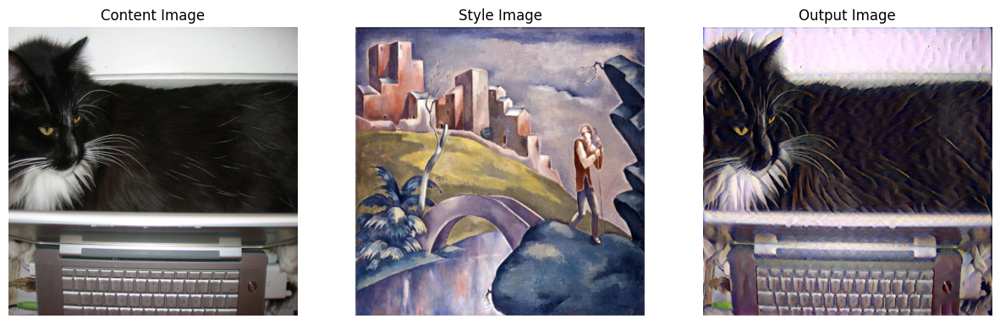

Building the style transfer model..
Optimizing..
run 50:
Style Loss : 27529.746094 Content Loss: 201.621796
run 100:
Style Loss : 12188.505859 Content Loss: 217.721268
run 150:
Style Loss : 7409.493652 Content Loss: 227.606339
run 200:
Style Loss : 5014.396484 Content Loss: 234.856079
run 250:
Style Loss : 3652.386963 Content Loss: 240.450409
run 300:
Style Loss : 2801.020752 Content Loss: 244.941299


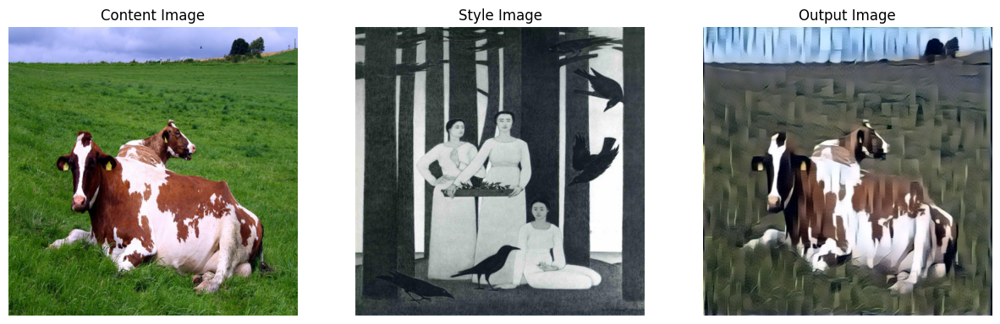

Building the style transfer model..
Optimizing..
run 50:
Style Loss : 33046.105469 Content Loss: 220.898849
run 100:
Style Loss : 12102.436523 Content Loss: 233.698456
run 150:
Style Loss : 6118.087891 Content Loss: 239.836853
run 200:
Style Loss : 3801.543701 Content Loss: 243.896225
run 250:
Style Loss : 2798.892578 Content Loss: 246.771057
run 300:
Style Loss : 2272.167725 Content Loss: 248.812286


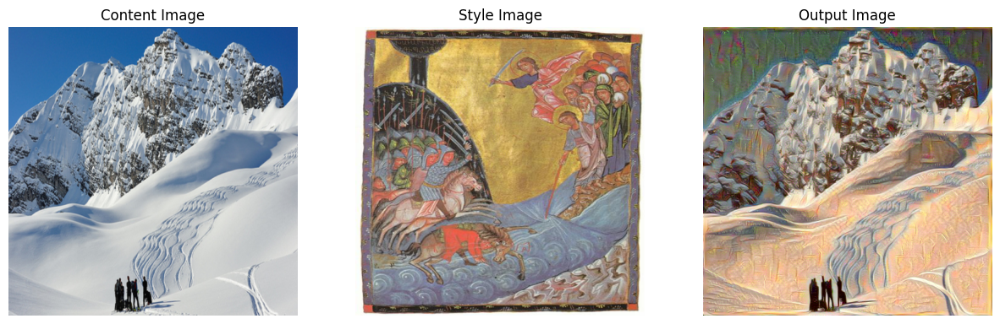

Building the style transfer model..
Optimizing..
run 50:
Style Loss : 33235.054688 Content Loss: 204.010361
run 100:
Style Loss : 15225.100586 Content Loss: 221.883209
run 150:
Style Loss : 8926.571289 Content Loss: 233.558472
run 200:
Style Loss : 6228.819336 Content Loss: 242.287949
run 250:
Style Loss : 4881.128418 Content Loss: 248.889587
run 300:
Style Loss : 4073.772217 Content Loss: 254.073044


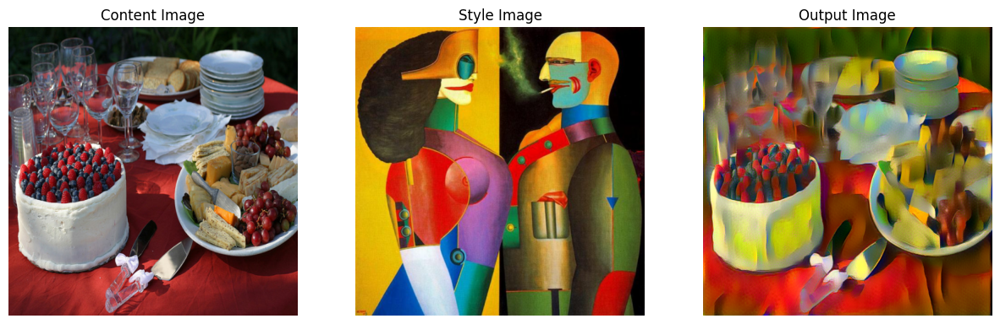

Building the style transfer model..
Optimizing..
run 50:
Style Loss : 142199.531250 Content Loss: 375.039856
run 100:
Style Loss : 52557.726562 Content Loss: 399.122559
run 150:
Style Loss : 29149.912109 Content Loss: 412.521118
run 200:
Style Loss : 18629.615234 Content Loss: 422.070740
run 250:
Style Loss : 13010.697266 Content Loss: 429.539154
run 300:
Style Loss : 9668.067383 Content Loss: 435.557892


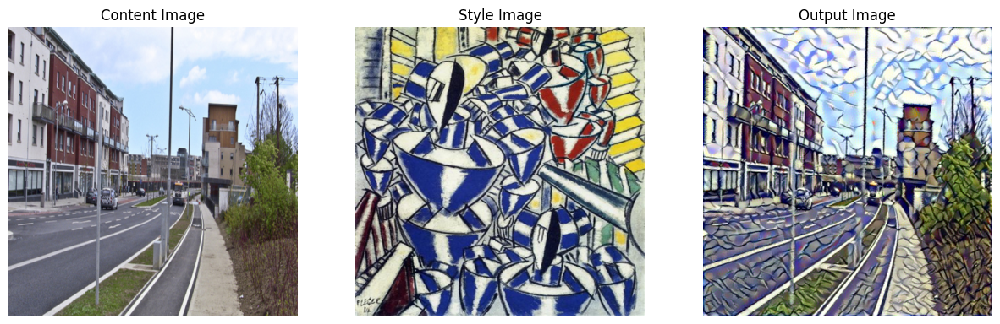

Building the style transfer model..
Optimizing..
run 50:
Style Loss : 16249.710938 Content Loss: 159.143372
run 100:
Style Loss : 8347.526367 Content Loss: 165.959763
run 150:
Style Loss : 6291.636719 Content Loss: 170.428162
run 200:
Style Loss : 5122.844727 Content Loss: 173.709900
run 250:
Style Loss : 4231.148926 Content Loss: 176.106186
run 300:
Style Loss : 3500.156250 Content Loss: 177.914474


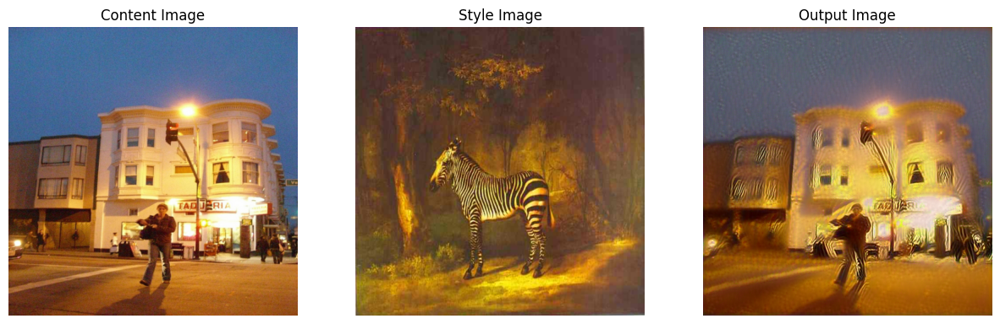

In [54]:
content = ['bear', 'building', 'cat-on-table', 'cat-sleeping', 'cat', 'cows', 'mountains', 'picnic', 'town', 'white-building']
style = ['bet-you', 'Erin-Hanson-Monet\'s-Bridge', 'head-of-paula-eyles', 'horse-cart', 'landscape-with-a-palace', 'not-detected', 'red-sea-passage', 'the-couple', 'the-exit-of-the-russian-ballet', 'zebra']

results = []

for content_image, style_image in zip(content, style):
    IMAGE_SIZE = (512, 512)

    content_img = load_image(f'Q3/content/{content_image}.jpg', size=IMAGE_SIZE)
    style_img = load_image(f'Q3/styles/{style_image}.jpg', size=IMAGE_SIZE)

    input_img = content_img.clone()

    st = StyleTransfer()

    style_weight = 1e10
    content_weight = 1e2

    optimizer = 'adam'
                
    output = st.run_style_transfer(content_img, style_img, input_img.clone(),
                                style_weight=style_weight,
                                content_weight=content_weight,
                                optimizer_type=optimizer,
                                num_steps=300)
    
    save_image(output, f'output1/output_{content_image}_{style_image}.jpg')
    
    display_images(content_img, style_img, output)
    
    results.append({
        'output': output.clone(),
        'content': content_image,
        'style': style_image
    })


- Strong performance on architectural and landscape scenes (buildings, mountains, streets) due to their well-defined geometric structures

- Struggles with fine details and faces, particularly noticeable in animal/cat photos where facial features become distorted

- Most effective when style images have distinctive patterns or strong color schemes (like geometric designs or vivid color palettes)

- Better preservation of object boundaries in high-contrast content images, but difficulty with subtle textures and gradients

- Transfer quality heavily depends on content-style compatibility - more natural results when compositional elements or color schemes align between the pair